In [24]:
from matplotlib import pyplot as plt
from pathlib import Path
import os
from torch import nn
import torch
from PIL import Image
from dotenv import load_dotenv
load_dotenv(".env")
DIR_DATA = os.getenv("DIR_DATA")

# local imports
from model import CAE_16, CAE_32
from data import from_path_to_patches
from callbacks import reconstruct_images

cks = dict({
    "cae16": Path.cwd() / "out" / "cae16.ckpt",
    "cae32": Path.cwd() / "out" / "cae32.ckpt",
})
modelname = dict({
    "cae16": CAE_16,
    "cae32": CAE_32,
})
path_img = Path(DIR_DATA)  / "01-21" / "frame_128.jpg"

In [53]:
def show_reconstruct(modelname, cks, path_img, evalname):
    model = modelname[evalname].load_from_checkpoint(cks[evalname])
    img, patches = from_path_to_patches(path_img)
    patches, dims = model.merge_patch_to_batch(patches.unsqueeze(0))
    out = model(patches)
    mse = nn.MSELoss()(out, patches)
    print("MSE: ", mse)
    psnr = 10 * torch.log10(1 / mse)
    print("PSNR: ", psnr)
    re_imgs = reconstruct_images(out, dims)
    comparison = torch.cat((img, re_imgs[0]), dim=1)
    comparison = comparison.unsqueeze(0)
    comparison = (comparison + 1) / 2.0
    comparison = comparison.detach().numpy()
    plt.figure(figsize=(20, 20), dpi=200)
    plt.imshow(comparison[0].transpose(1, 2, 0))
    return model

def show_encoded(model):
    # Visualize the first encoded 128x128 patch
    encoded = []
    for i in range(16):
        tmp = model.encoded[0][i].cpu().detach().numpy()
        encoded += [tmp]
    plt.figure(figsize=(8, 8))
    for i in range(16):
        plt.subplot(4, 4, i+1)
        plt.xticks([])
        plt.yticks([])
        plt.tight_layout()
        plt.imshow(encoded[i], cmap="gray")

MSE:  tensor(0.0099, grad_fn=<MseLossBackward0>)
PSNR:  tensor(20.0297, grad_fn=<MulBackward0>)


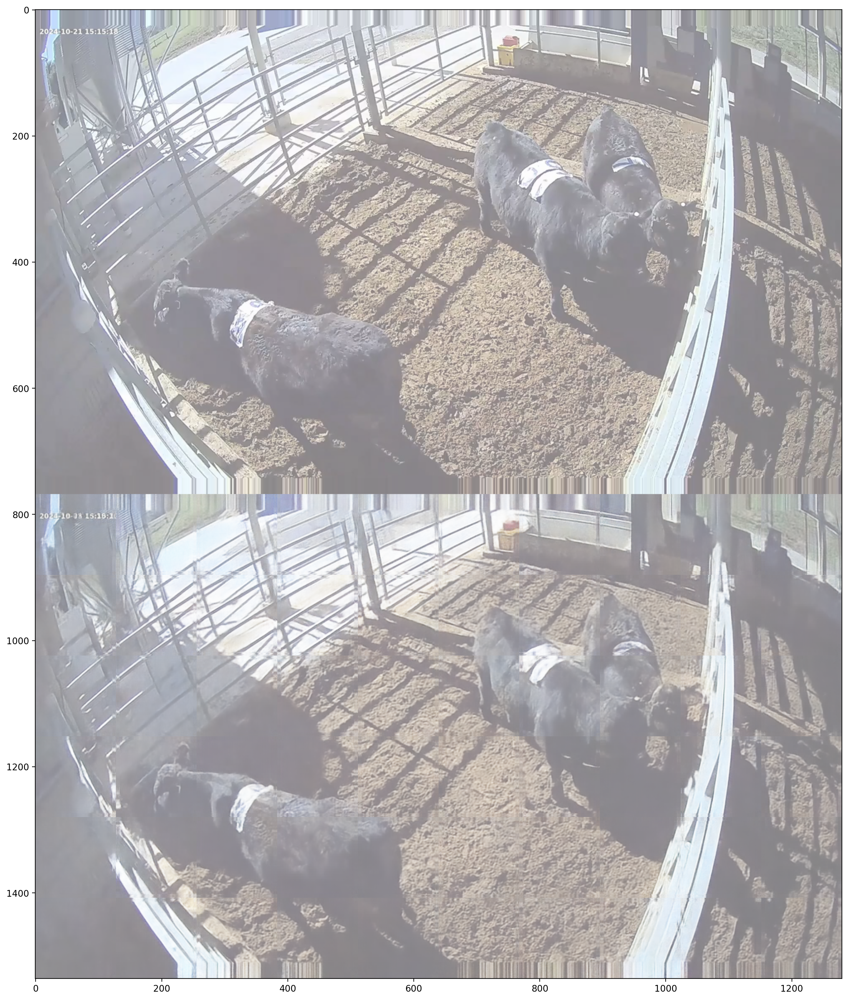

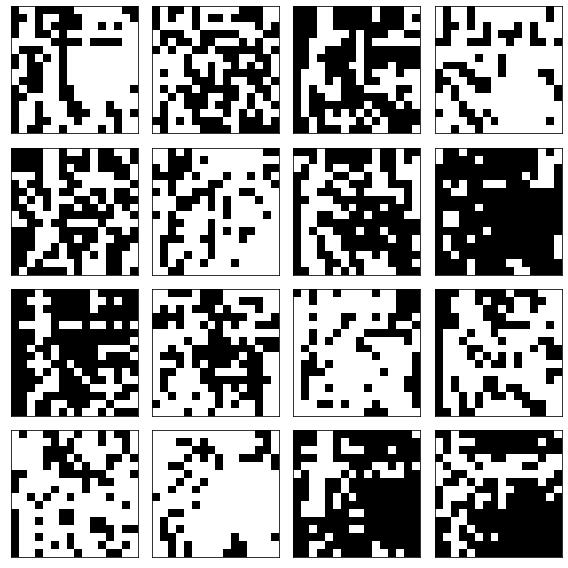

In [57]:
model = show_reconstruct(modelname, cks, path_img, "cae16")
show_encoded(model)

MSE:  tensor(0.0022, grad_fn=<MseLossBackward0>)
PSNR:  tensor(26.5621, grad_fn=<MulBackward0>)


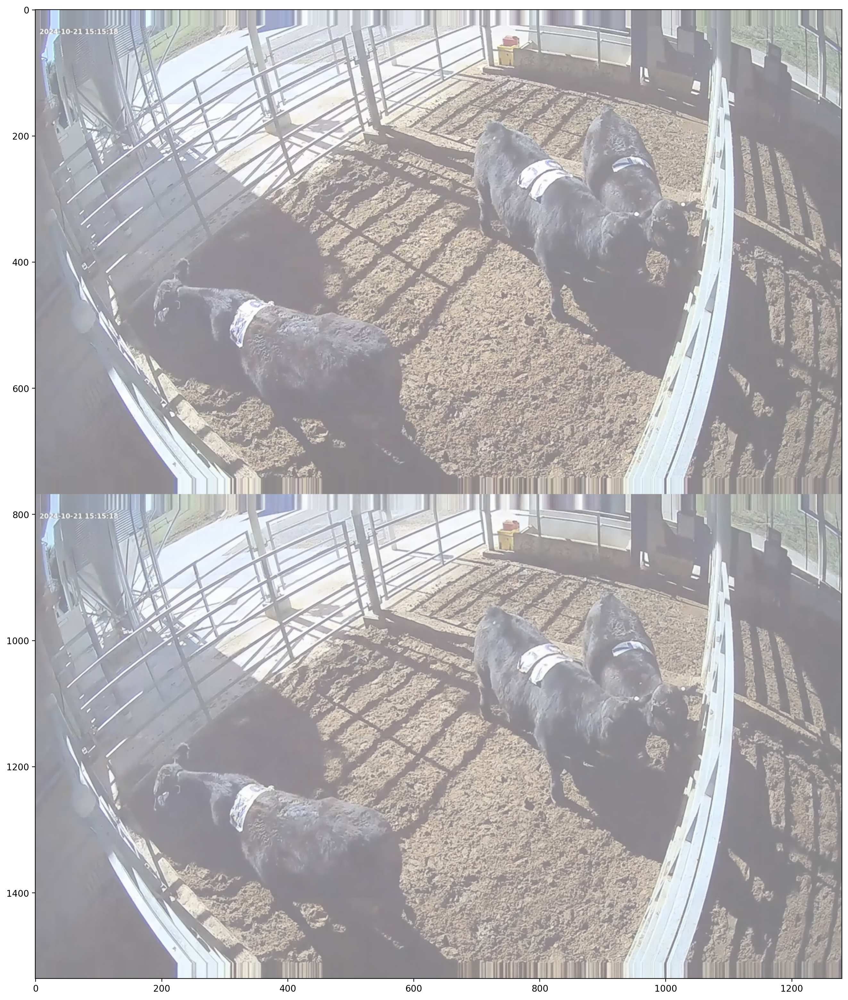

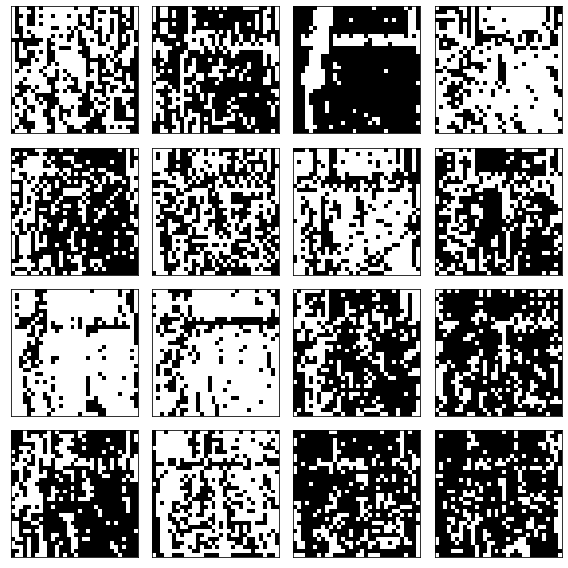

In [56]:
model = show_reconstruct(modelname, cks, path_img, "cae32")
show_encoded(model)